# Решение тестового задания

Провести исследование показов рекламы с целью понять на сколько отличается eCPM в зависимости от географии (города) юзера, версии ОС и других параметров.
#### Исходные данные:

In [1]:
import pandas as pd
import numpy as np

df = pd.read_csv('us events ad_revenue filtered 03.02-07.02.csv')
df.head()

,profile_id,os_version,device_manufacturer,device_model,device_type,device_locale,event_name,event_json,event_datetime,event_timestamp,event_receive_datetime,event_receive_timestamp,connection_type,operator_name,country_iso_code,city
0,JLjpGzDHBQm,11,Samsung,Galaxy Tab S6,tablet,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-04 20:02:28,1643994148,2022-02-06 17:58:19,1644159499,wifi,NaN,US,Norwalk
1,JLjpGzDHBQm,11,Samsung,Galaxy Tab S6,tablet,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-04 20:02:45,1643994165,2022-02-06 17:58:19,1644159499,wifi,NaN,US,Norwalk
2,JLkVacrzHY6,11,Google,Pixel 2,phone,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-05 17:53:05,1644072785,2022-02-06 16:59:29,1644155969,wifi,Verizon,US,Charlotte
3,JMC6wG3cX0f,10,Samsung,Galaxy S9,phone,en_US,c_ad_revenue,"{""ad_type"":""int"",""placement"":""next_level"",""vie...",2022-02-06 17:09:01,1644156541,2022-02-06 17:09:24,1644156564,wifi,T-Mobile,US,Cocoa
4,JLzWWTJfi1b,10,Samsung,Galaxy S9,phone,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-06 17:15:38,1644156938,2022-02-06 17:16:16,1644156976,cell,Verizon,US,NaN


# Обозначения параметров

**ad_type** – формат рекламы (int - полноэкранная, banner - баннер или rv - видеоролик)\
**placement** – когда/где был показ рекламы в игре\
**view_index** – номер показа конкретного формата рекламы для юзера (не поддерживается для баннеров)\
**revenue** – доход от конкретного показа рекламы (**eCPM = revenue * 1000**)\
**ads_ltv** – накапливающийся доход от рекламы, равен сумме всех revenue юзера\
**network_name** – рекламная сеть, от которой был показ

<img src="1-1024x615.jpg" alt="drawing" width="500"/>

**eCPM** = (стоимость активного действия * количество активных действий) / Количество показов * 1000

In [2]:
import json

example_json_record = json.loads(df['event_json'][0])
all_json_records = df['event_json'].apply(json.loads)
example_json_record

{'ad_type': 'banner',
 'placement': '',
 'view_index': 1,
 'session_view_index': 0,
 'cur_ticks': 637795729492245130,
 'session_length': 705.8807,
 'revenue': 0.000510313,
 'ads_ltv': 0.487876676518837,
 'ecpm_sma': 0.511508107185364,
 'normalized_ecpm_sma': 0.511508107185364,
 'value': 0.000510313,
 'currency': 'USD',
 'ad_country_code': 'US',
 'network_name': 'Google AdMob',
 'ad_unit_id': '64c6b1114ea8c1cc',
 'ad_network_placement': 'ca-app-pub-7511632782617496/8825263691',
 'creativeId': 'CJ3XirfD5vUCFYPnKAUdG3MOYQ'}

In [3]:
# Вытаскиваем данные из JSON-а и добавляем к исходной таблице 

df_nested_json = pd.json_normalize(all_json_records)
df_nested_json = pd.concat([df_nested_json, df], axis=1)
df_nested_json = df_nested_json.drop(['event_json'], axis=1)
# df_nested_json = df_nested_json.drop(['event_json', 'operator_name', 'country_iso_code', 'cur_ticks', 
#                                       'currency', 'ad_country_code', 'ad_unit_id', 'creativeId', 
#                                       'device_model', 'device_locale', 'event_timestamp', 
#                                       'event_receive_timestamp', 'ad_network_placement',
#                                       'device_manufacturer', 'event_name'], axis=1)
df_nested_json = df_nested_json.loc[:,~df_nested_json.columns.duplicated()].copy()
df_nested_json['eCPM'] = df_nested_json["revenue"]*1000

df_nested_json.head()

,ad_type,placement,view_index,session_view_index,cur_ticks,session_length,revenue,ads_ltv,ecpm_sma,normalized_ecpm_sma,...,event_name,event_datetime,event_timestamp,event_receive_datetime,event_receive_timestamp,connection_type,operator_name,country_iso_code,city,eCPM
0,banner,,1,0,637795729492245130,705.88070,0.000510,0.487877,0.511508,0.511508,...,c_ad_revenue,2022-02-04 20:02:28,1643994148,2022-02-06 17:58:19,1644159499,wifi,NaN,US,Norwalk,0.510313
1,banner,,1,0,637795729659949790,722.65120,0.000510,0.488387,0.511389,0.511389,...,c_ad_revenue,2022-02-04 20:02:45,1643994165,2022-02-06 17:58:19,1644159499,wifi,NaN,US,Norwalk,0.510313
2,banner,,1,0,637796515863735930,431.81290,0.002386,0.678479,0.928597,0.928597,...,c_ad_revenue,2022-02-05 17:53:05,1644072785,2022-02-06 16:59:29,1644155969,wifi,Verizon,US,Charlotte,2.386163
3,int,next_level,1,1,637797353426827330,125.94960,0.013894,0.013894,13.782633,13.893784,...,c_ad_revenue,2022-02-06 17:09:01,1644156541,2022-02-06 17:09:24,1644156564,wifi,T-Mobile,US,Cocoa,13.893784
4,banner,,1,0,637797357392197840,12.71129,0.006828,0.060571,1.660282,1.660282,...,c_ad_revenue,2022-02-06 17:15:38,1644156938,2022-02-06 17:16:16,1644156976,cell,Verizon,US,NaN,6.827570


## Задание 1. Для каждого формата рекламы:
### a. построить распределение средних eCPM-ов юзеров

c:\users\roman\appdata\local\programs\python\python37\lib\site-packages\pandas\plotting\_matplotlib\hist.py:382: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  **kwds,


eCPM                                                        \
         describe                                                         
            count       mean        std       min        25%        50%   
ad_type                                                                   
banner   815984.0   0.744113   1.401274  0.000064   0.041673   0.494196   
int       37613.0  36.209634  48.186808  0.000000  11.965651  21.398855   
rv         6482.0  65.051165  75.926894  0.160666  28.025083  31.468961   

                                
                                
               75%         max  
ad_type                         
banner    0.531158   63.750000  
int      37.047733  937.195984  
rv       80.640000  916.205811

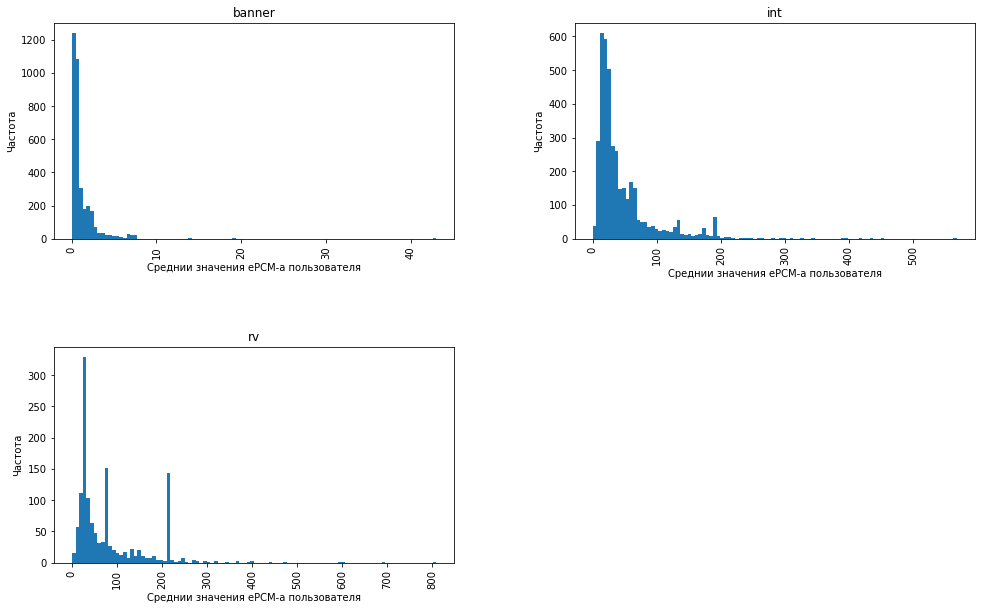

In [9]:
import matplotlib.pyplot as plt

# группируем по формату рекламы и считаем средние eCPM-ов по каждому юзеру для каждого вида рекламы
temp_user = df_nested_json.groupby(['ad_type', 'profile_id'])['eCPM'].mean().reset_index()

# строим графики распределения средних
fig = plt.figure(figsize=(16, 10))
ax = fig.gca()
temp_user_plot = temp_user['eCPM'].hist(ax=ax, bins=100, by=temp_user['ad_type'])

for axes in temp_user_plot.flatten():
    axes.set_xlabel("Среднии значения ePCM-а пользователя")
    axes.set_ylabel("Частота")
    
description = {'eCPM': ['describe']}
df_nested_json.groupby(['ad_type']).agg(description)

#### Заключения по пункту
Наибольшая выручка по видам рекламы происходит из полноэкранной рекламы (937.195984 у.е.), вторым значимым видом рекамы, немного уступая int, явялется видео-рекалама: (916.205811 у.е.), самым последним - баннеры, усупая первым двум почти в 13 раз.
Распределения средних зачений eCPM по пользователям имеюют явно выраженное распредлеение Фишера (результаты проверки критерия на нормальность привидены ниже).
Чаще всего показывается баннеры, затем полноэкранная. Наименьшие показы рекланы у видео.

### b. отобразить средние eCPM-ы по городам, версиям ОС

по городам:

In [13]:
def plotting_bars(table, param, metrics, type_param):

    if metrics == 'mean':
        temp = table.groupby(['ad_type', param])['eCPM'].mean().reset_index()
        temp = temp.replace(np.nan, 'untitled')
    elif metrics == 'sum':
        temp = table.groupby(['ad_type', param])['revenue'].sum().reset_index()
        temp = temp.replace(np.nan, 'untitled')
    
    # графики
    if type_param == True:
        banner = temp.loc[(temp['ad_type'] == 'banner')].sort_values(by='eCPM', ascending=False)
        banner_plot_bar = banner[:10].plot(kind='bar', x=param, title='banner', ylabel='eCPM',
                 xlabel=param, figsize=(16, 5))
    
        int_add = temp.loc[(temp['ad_type'] == 'int')].sort_values(by='eCPM', ascending=False)
        int_add_plot_bar = int_add[:10].plot(kind='bar', x=param, title='int', ylabel='eCPM',
                 xlabel=param, figsize=(16, 5))

        rv = temp.loc[(temp['ad_type'] == 'rv')].sort_values(by='eCPM', ascending=False)
        rv_plot_bar = rv[:10].plot(kind='bar', x=param, title='rv', ylabel='eCPM',
                 xlabel=param, figsize=(16, 5))
    elif type_param == False:
        banner = temp.loc[(temp['ad_type'] == 'banner')].sort_values(by='revenue', ascending=False)
        banner_plot_bar = banner[:10].plot(kind='bar', x=param, title='banner', ylabel='revenue',
                 xlabel=param, figsize=(16, 5))
    
        int_add = temp.loc[(temp['ad_type'] == 'int')].sort_values(by='revenue', ascending=False)
        int_add_plot_bar = int_add[:10].plot(kind='bar', x=param, title='int', ylabel='revenue',
                 xlabel=param, figsize=(16, 5))

        rv = temp.loc[(temp['ad_type'] == 'rv')].sort_values(by='revenue', ascending=False)
        rv_plot_bar = rv[:10].plot(kind='bar', x=param, title='rv', ylabel='revenue',
                 xlabel=param, figsize=(16, 5))
    
    
    return banner_plot_bar, int_add_plot_bar, rv_plot_bar

(<matplotlib.axes._subplots.AxesSubplot at 0x213bab00160>,
 <matplotlib.axes._subplots.AxesSubplot at 0x213bcce79b0>)

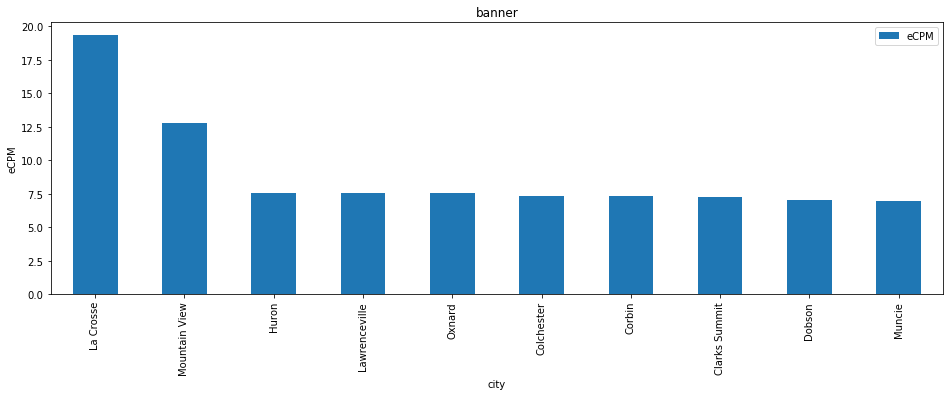

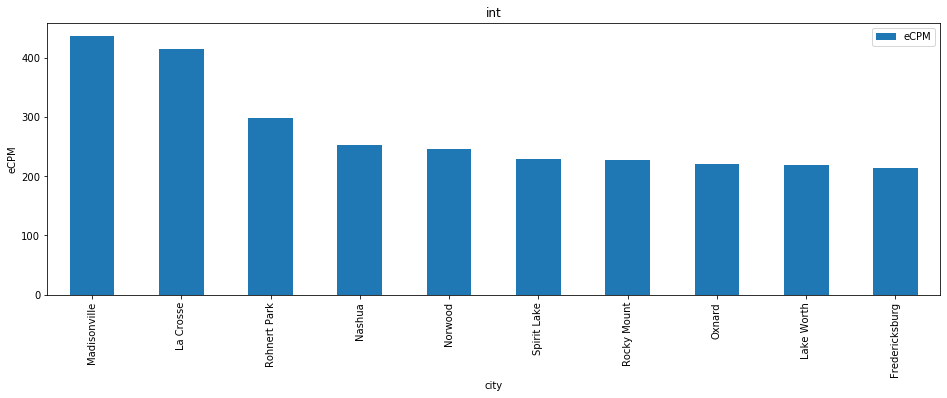

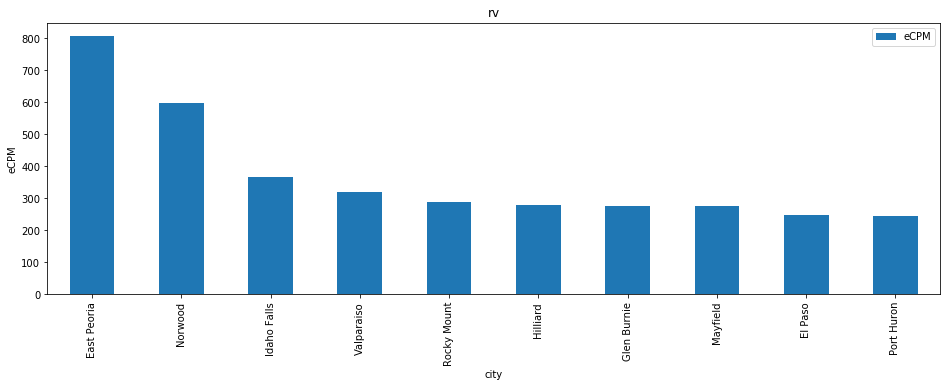

In [16]:
plotting_bars(df_nested_json, 'city', 'mean', True)

Топ 3 города по охвату и осваиванию рекламы (метрика eCPM) -- это Ла-Кру, Миннеаполис, Ист-Пеориа и другие. 

по версиям ОС:

(<matplotlib.axes._subplots.AxesSubplot at 0x1f9bbc6b5c0>,
 <matplotlib.axes._subplots.AxesSubplot at 0x1f9be030278>)

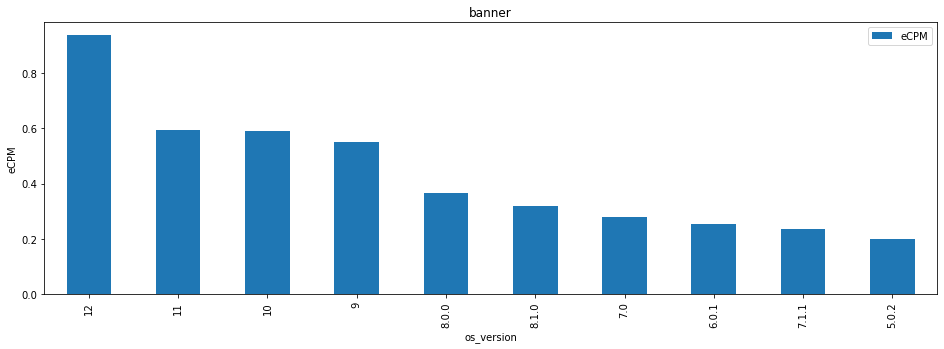

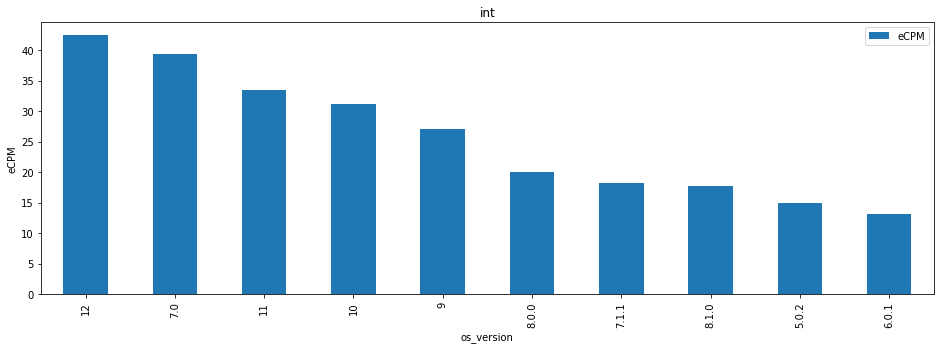

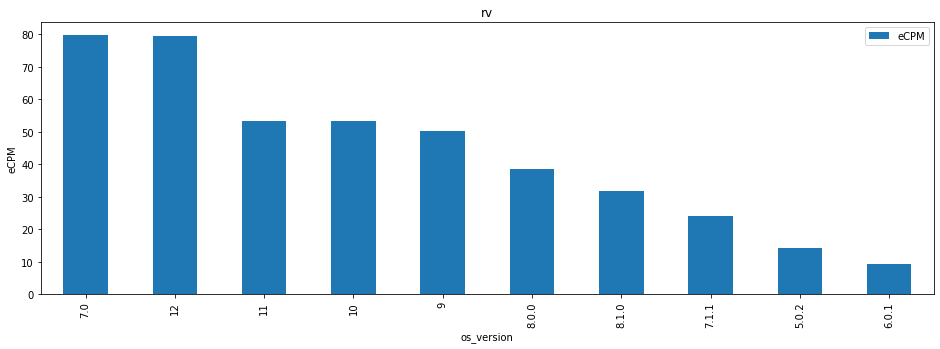

In [7]:
plotting_bars(df_nested_json, 'os_version', 'mean', True)

Интересно, что для рекламы типа видео и полноэкранной наибольшие значения метрики eCPM находятся у версии ОС 7 и 12. Необходимо провести анализ на корреляцию типа устройства, изготовителя и его версии ОС.

### c. отобразить суммарные доходы по городам, версиям ОС

по городам:

(<matplotlib.axes._subplots.AxesSubplot at 0x213c04ae860>,
 <matplotlib.axes._subplots.AxesSubplot at 0x213bdffb668>)

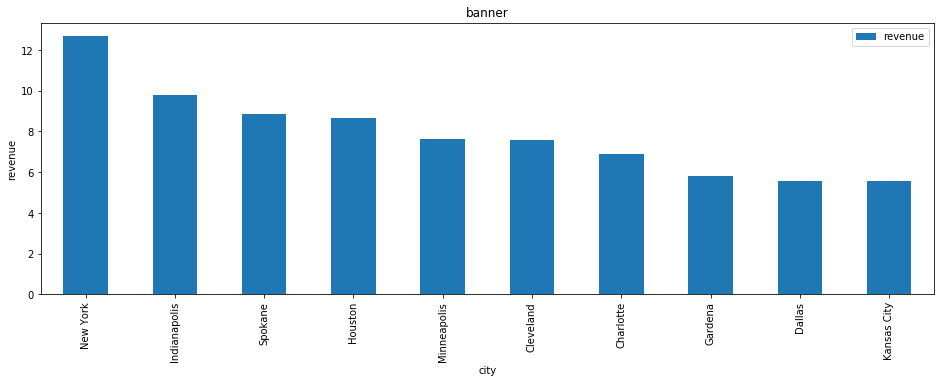

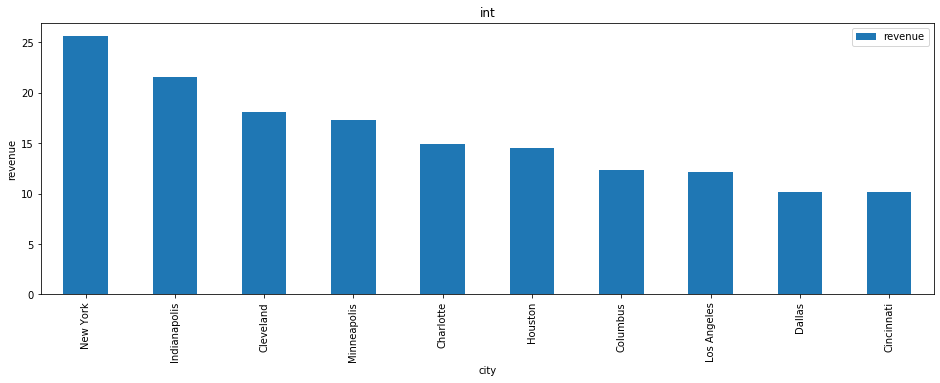

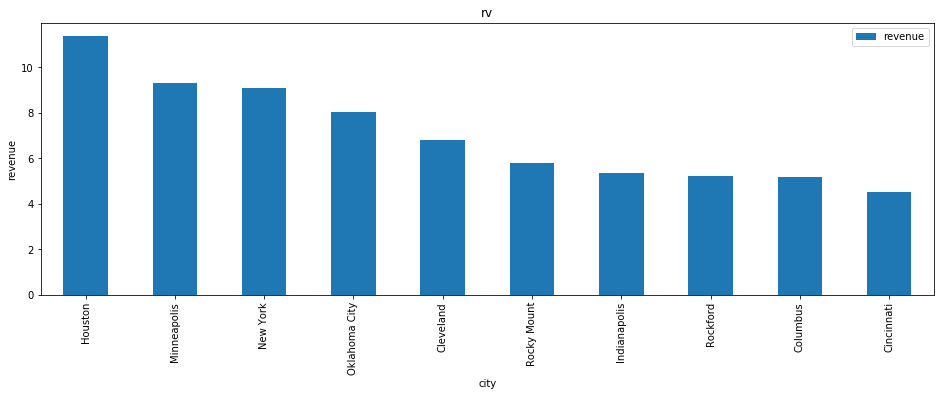

In [15]:
plotting_bars(df_nested_json, 'city', 'sum', False)

Топ городов по охвату и осваиванию статической рекламы: Ню-Йорк, Индиапполис, Кливленд, Спокан. Для видеорекламы это Хьюстон, Миннеаполис и Нью-Йорк. На эти города приходится наибольшая выручка по метрике revenue.

по версии ОС:

(<matplotlib.axes._subplots.AxesSubplot at 0x213ba8d6ba8>,
 <matplotlib.axes._subplots.AxesSubplot at 0x213c5ebda20>)

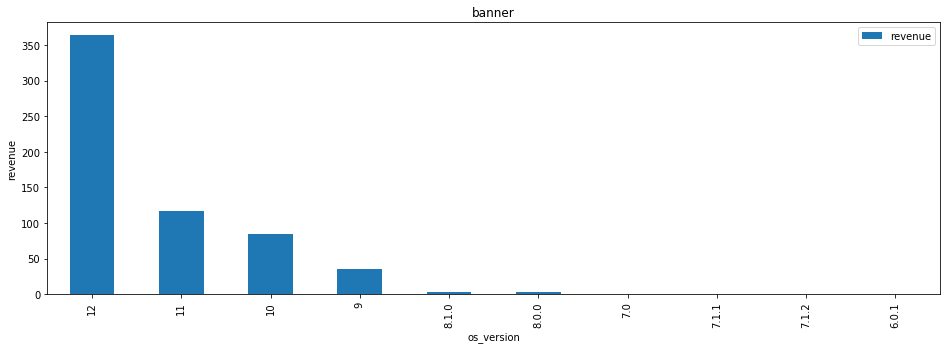

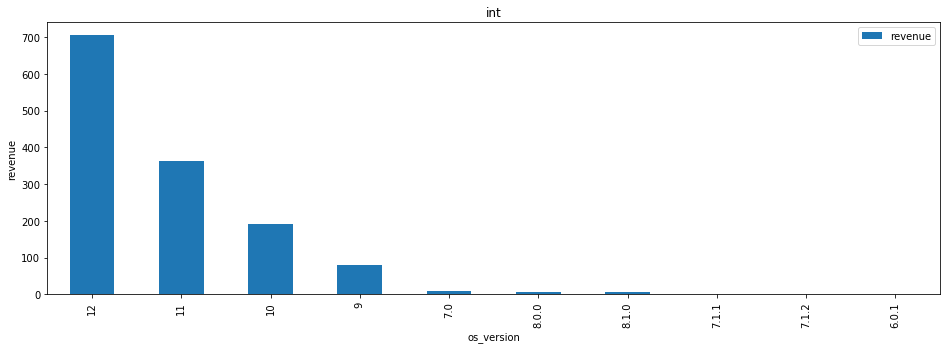

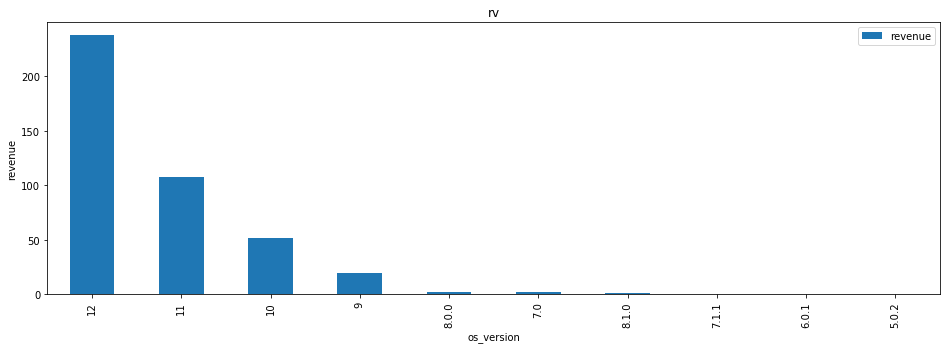

In [14]:
plotting_bars(df_nested_json, 'os_version', 'sum', False)

По версиям ОС, как и ожидалось, наибольшие суммы дохода оказались у тех устройств, у которых установлены посдение версии операционных систем: 12, 11, 10 и 9.

## 2. Учесть статистическую значимость для п.1b (отобразить, отфильтровать незначимое или хотя бы прокомментировать). Объяснить решение.
### Посчитаем персентиль для п.1b
**Вывод:** 

c:\users\roman\appdata\local\programs\python\python37\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
C:\Users\Roman\AppData\Roaming\Python\Python37\site-packages\matplotlib\cbook\__init__.py:1402: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  ndim = x[:, None].ndim
C:\Users\Roman\AppData\Roaming\Python\Python37\site-packages\matplotlib\axes\_base.py:276: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  x = x[:, np.newaxis]
C:\Users\Roman\Ap

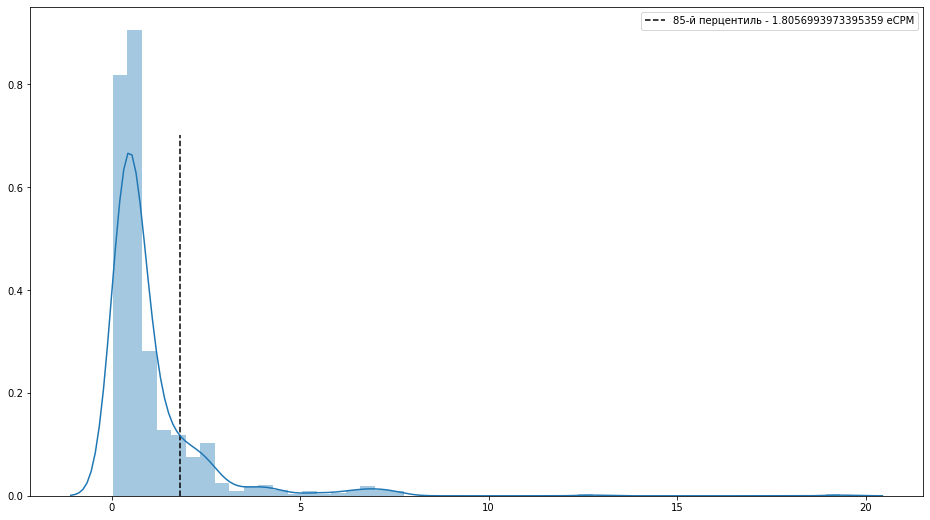

In [36]:
import numpy as np
import seaborn as sns

temp = df_nested_json.groupby(['ad_type', 'city'])['eCPM'].mean().reset_index()
temp = temp.replace(np.nan, 'untitled')

temp_OS = df_nested_json.groupby(['ad_type', 'os_version'])['eCPM'].mean().reset_index()
temp_OS = temp_OS.replace(np.nan, 'untitled')

banner = temp.loc[(temp['ad_type'] == 'banner')].sort_values(by='eCPM', ascending=False)
int_add = temp.loc[(temp['ad_type'] == 'int')].sort_values(by='eCPM', ascending=False)
rv = temp.loc[(temp['ad_type'] == 'rv')].sort_values(by='eCPM', ascending=False)

banner_OS = temp.loc[(temp['ad_type'] == 'banner')].sort_values(by='eCPM', ascending=False)
int_add_OS = temp.loc[(temp['ad_type'] == 'int')].sort_values(by='eCPM', ascending=False)
rv_OS = temp.loc[(temp['ad_type'] == 'rv')].sort_values(by='eCPM', ascending=False)    

perc_banner = np.percentile(banner['eCPM'], 85)
perc_int = np.percentile(int_add['eCPM'], 85)
perc_rv = np.percentile(rv['eCPM'], 85)

plt.figure(figsize=(16, 9))
sns.distplot(banner['eCPM'])
# sns.distplot(int_add['eCPM'])
# sns.distplot(rv_OS['eCPM'])

plt.vlines(perc_banner, linestyles='dashed', ymin=0, ymax=0.7, 
           label=f'85-й перцентиль - {perc_banner} eCPM')
# plt.vlines(perc_int, linestyles='dashed', ymin=0, ymax=0.025, 
#            label=f'85-й перцентиль - {perc_banner} eCPM')
# plt.vlines(perc_rv, linestyles='dashed', ymin=0, ymax=0.02, 
#            label=f'85-й перцентиль - {perc_banner} eCPM')

plt.title('')
plt.xlabel('')
plt.ylabel('')
plt.legend()
plt.show()

### Проведем ABC-анализ для п.1b

In [37]:
cols_to_remove = []

df_nested_json_temp = df_nested_json

for col in df_nested_json_temp.columns:
    try:
        _ = df_nested_json_temp[col].astype(float)
    except ValueError:
#         print('Couldn\'t covert %s to float' % col)
        cols_to_remove.append(col)
        pass

# keep only the columns in df that do not contain string
df_nested_json_temp = df_nested_json_temp[[col for col in df_nested_json_temp.columns if col not in cols_to_remove]]

df_nested_json_temp = df_nested_json_temp.join(df_nested_json['ad_type'])
df_nested_json_temp = df_nested_json_temp.join(df_nested_json['os_version'])
df_nested_json_temp = df_nested_json_temp.join(df_nested_json['city'])

df_nested_json_temp


# df_nested_json['os_version']

,view_index,session_view_index,cur_ticks,session_length,revenue,ads_ltv,ecpm_sma,normalized_ecpm_sma,value,event_timestamp,event_receive_timestamp,eCPM,ad_type,os_version,city
0,1,0,637795729492245130,705.88070,0.000510,0.487877,0.511508,0.511508,0.000510,1643994148,1644159499,0.510313,banner,11,Norwalk
1,1,0,637795729659949790,722.65120,0.000510,0.488387,0.511389,0.511389,0.000510,1643994165,1644159499,0.510313,banner,11,Norwalk
2,1,0,637796515863735930,431.81290,0.002386,0.678479,0.928597,0.928597,0.002386,1644072785,1644155969,2.386163,banner,11,Charlotte
3,1,1,637797353426827330,125.94960,0.013894,0.013894,13.782633,13.893784,0.013894,1644156541,1644156564,13.893784,int,10,Cocoa
4,1,0,637797357392197840,12.71129,0.006828,0.060571,1.660282,1.660282,0.006828,1644156938,1644156976,6.827570,banner,10,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
860074,1,0,637794449687371810,474.15260,0.000020,1.007506,0.080914,0.080914,0.000020,1643866167,1643866177,0.019972,banner,12,Elmira
860075,1,0,637794223717667630,10.89967,0.006740,0.277541,3.379858,3.379858,0.006740,1643843571,1643843688,6.740355,banner,12,Cherry Hill
860076,1,0,637794223868486920,25.97572,0.002780,0.280321,3.319878,3.319878,0.002780,1643843586,1643843688,2.780058,banner,12,Cherry Hill
860077,1,0,637794223980531730,37.18013,0.002780,0.283101,3.265896,3.265896,0.002780,1643843597,1643843688,2.780058,banner,12,Cherry Hill


C:\Users\Roman\AppData\Roaming\Python\Python37\site-packages\matplotlib\cbook\__init__.py:1402: FutureWarning:

Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.

C:\Users\Roman\AppData\Roaming\Python\Python37\site-packages\matplotlib\axes\_base.py:276: FutureWarning:

Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.

C:\Users\Roman\AppData\Roaming\Python\Python37\site-packages\matplotlib\axes\_base.py:278: FutureWarning:

Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.



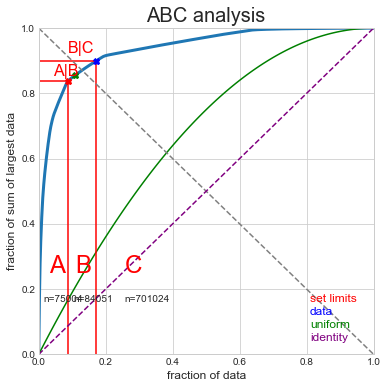

,view_index,session_view_index,cur_ticks,session_length,revenue,ads_ltv,ecpm_sma,normalized_ecpm_sma,value,event_timestamp,event_receive_timestamp,eCPM,ad_type,os_version,city,abc
3,1,1,637797353426827330,125.94960,0.013894,0.013894,13.782633,13.893784,0.013894,1644156541,1644156564,13.893784,int,10,Cocoa,A
4,1,0,637797357392197840,12.71129,0.006828,0.060571,1.660282,1.660282,0.006828,1644156938,1644156976,6.827570,banner,10,NaN,A
20,3,1,637797360006785730,274.15410,0.011280,0.082685,29.002464,29.236355,0.011280,1644157199,1644161432,11.280232,int,10,NaN,A
39,20,1,637797288105819330,191.71200,0.009871,0.530309,12.604902,12.706555,0.009871,1644150010,1644150624,9.870711,int,11,Jamestown,A
44,1,0,637797294284810150,809.61320,0.006828,0.537136,0.856678,0.856678,0.006828,1644150627,1644150669,6.827570,banner,11,Jamestown,A
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
859990,10,1,637794433955651710,417.25720,0.018046,0.944682,45.742691,46.111584,0.018046,1643864594,1643864686,18.045628,int,12,Elmira,A
859991,2,1,637794433841770450,405.86900,0.028240,0.926596,109.959999,110.846771,0.028240,1643864583,1643864591,28.240000,rv,12,Elmira,A
860034,10,1,637794443780927210,480.27540,0.023190,0.980897,43.487453,43.838158,0.023190,1643865577,1643865592,23.190308,int,12,Elmira,A
860039,10,1,637794444878853380,101.86180,0.020850,1.004186,41.223705,41.556156,0.020850,1643865687,1643865701,20.849997,int,12,Elmira,A


In [99]:
from abc_analysis import abc_analysis

def the_best_abc_analysis(table):
    abc = abc_analysis(table['eCPM'], True) # показательным параметром у нас будет, соответственно, величина eCPM
    abc

    a_index = abc['Aind']
    b_index = abc['Bind']
    c_index = abc['Cind']

    cond_list = [table.index.isin(a_index),
                 table.index.isin(b_index),
                 table.index.isin(c_index)]

    choose_list = ['A', 'B', 'C']

    table['abc'] = np.select(cond_list, choose_list)
    table.sort_values(by=['eCPM'], ascending=False)
    
    group_A = table.loc[table['abc'] == 'A']
    
    return group_A

Выбрали те значения, которые вхоядт в группу А - наибольшая выручка находится в 75004 значений (было: 860079) - без группировок по городам и ОС. С группировками:

C:\Users\Roman\AppData\Roaming\Python\Python37\site-packages\matplotlib\cbook\__init__.py:1402: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  ndim = x[:, None].ndim
C:\Users\Roman\AppData\Roaming\Python\Python37\site-packages\matplotlib\axes\_base.py:276: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  x = x[:, np.newaxis]
C:\Users\Roman\AppData\Roaming\Python\Python37\site-packages\matplotlib\axes\_base.py:278: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  y = y[:, np.newaxis]


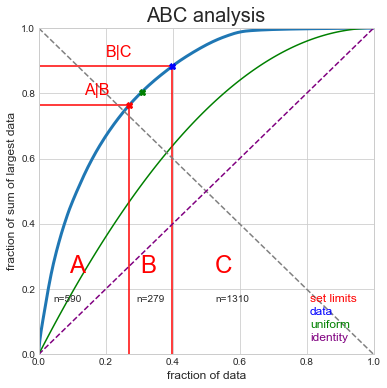

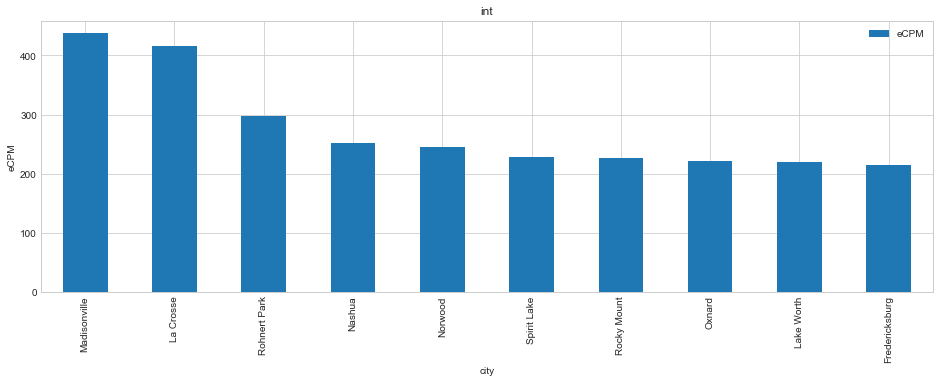

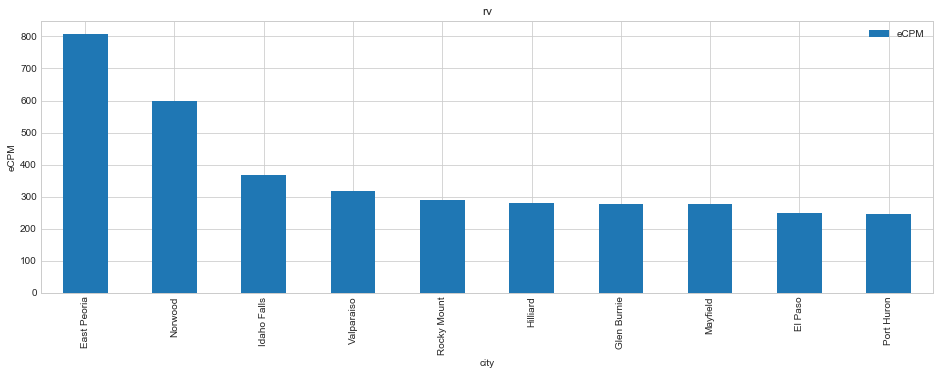

In [67]:
temp = df_nested_json.groupby(['ad_type', 'city'])['eCPM'].mean().reset_index()
temp = temp.replace(np.nan, 'untitled')

aaa = the_best_abc_analysis(temp)

 # графики
# temp_city_banner = aaa.loc[(aaa['ad_type'] == 'banner')].sort_values(by='eCPM', ascending=False)
# temp_city_banner
# temp_city_banner_plot_bar = temp_city_banner.plot(kind='bar', x='city', title='banner', ylabel='eCPM',
#              xlabel='city', figsize=(16, 5))

temp_city_int = aaa.loc[(aaa['ad_type'] == 'int')].sort_values(by='eCPM', ascending=False)
temp_city_int_plot_bar = temp_city_int[:10].plot(kind='bar', x='city', title='int', ylabel='eCPM',
             xlabel='city', figsize=(16, 5))

temp_city_rv = aaa.loc[(aaa['ad_type'] == 'rv')].sort_values(by='eCPM', ascending=False)
temp_city_rv_plot_bar = temp_city_rv[:10].plot(kind='bar', x='city', title='rv', ylabel='eCPM',
             xlabel='city', figsize=(16, 5))

После проведения ABC-анализа оказалось, что доход от баннерной рекламы при группировке по городам совсем незначителен и не включается в группу А. Остаются только видео и полноэкранная. Топ городов приведены на графиках. Корреляции между ними не видно. Проведем аналогичные вычисления при группировке по версиям ОС: 

C:\Users\Roman\AppData\Roaming\Python\Python37\site-packages\matplotlib\cbook\__init__.py:1402: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  ndim = x[:, None].ndim
C:\Users\Roman\AppData\Roaming\Python\Python37\site-packages\matplotlib\axes\_base.py:276: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  x = x[:, np.newaxis]
C:\Users\Roman\AppData\Roaming\Python\Python37\site-packages\matplotlib\axes\_base.py:278: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  y = y[:, np.newaxis]


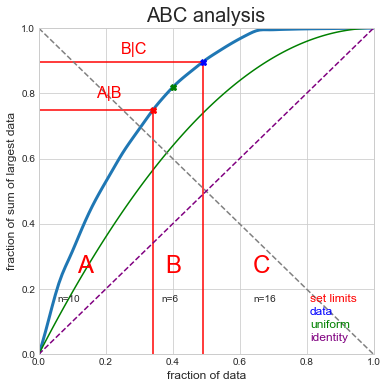

(   ad_type os_version       eCPM abc
 27      rv        7.0  79.662468   A
 24      rv         12  79.568911   A
 23      rv         11  53.378872   A
 22      rv         10  53.336882   A
 31      rv          9  50.151552   A
 29      rv      8.0.0  38.614653   A
 30      rv      8.1.0  31.830249   A,    ad_type os_version       eCPM abc
 13     int         12  42.391070   A
 16     int        7.0  39.266162   A
 12     int         11  33.468471   A)

In [78]:
temp_OS = df_nested_json.groupby(['ad_type', 'os_version'])['eCPM'].mean().reset_index()
temp_OS = temp_OS.replace(np.nan, 'untitled')

bbb = the_best_abc_analysis(temp_OS)

temp_city_rv = bbb.loc[(bbb['ad_type'] == 'rv')].sort_values(by='eCPM', ascending=False)
temp_city_int = bbb.loc[(bbb['ad_type'] == 'int')].sort_values(by='eCPM', ascending=False)
temp_city_rv, temp_city_int

Наблюдение:
Наибольшая выручка приходится от рекламах, показанных на устройствах с версией 7 и 12 для видео и 12 для полноэкранной. Баннеры также исключениы при ABC-анализе.  

C:\Users\Roman\AppData\Roaming\Python\Python37\site-packages\matplotlib\cbook\__init__.py:1402: FutureWarning:

Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.

C:\Users\Roman\AppData\Roaming\Python\Python37\site-packages\matplotlib\axes\_base.py:276: FutureWarning:

Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.

C:\Users\Roman\AppData\Roaming\Python\Python37\site-packages\matplotlib\axes\_base.py:278: FutureWarning:

Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.



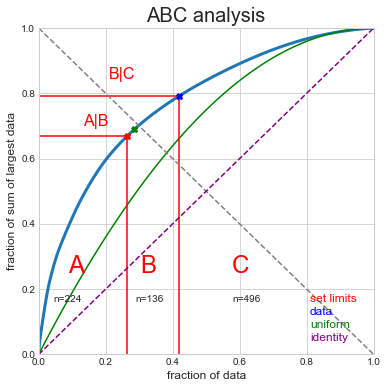

ShapiroResult(statistic=0.6002786755561829, pvalue=1.6793443868655324e-22)

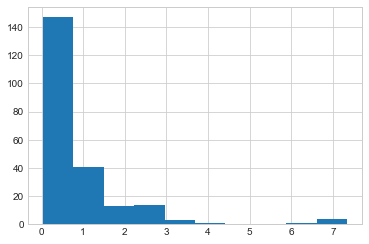

In [100]:
# Проверка на нормальность распределения

from scipy import stats

group_A = the_best_abc_analysis(banner)

shapiro_test = stats.shapiro(group_A['eCPM'].values)

group_A['eCPM'].hist()
shapiro_test

# Данные подчиняются закону распределения Фишера

Гипотеза H0: Выборки имеют нормальное распределение.
Гипотеза H1: Выборки имеют распределени отличное отнормального.
Как и было сказано ранее, тест Шапиро-Уилка показал, что выборки имеют не нормальное распределение. Значение p-value ниже уровня значимости alfa=0.05%, соответственно, мы отверкагем нулевую гипотезу.

### Применим метод главных компонент, чтобы понять какие показатели следует рассмотреть в дальнешем анализе.
Сначала из исходной таблицы убираем колонки, где содержатся текстовые значения. Так как нормализацию string значений проводить невозможно или крайне затруднительно. Затем добавим в полученную таблицу тип рекламы, версию ОС и город. И нормализуем значения.

C:\Users\Roman\AppData\Roaming\Python\Python37\site-packages\matplotlib\cbook\__init__.py:1402: FutureWarning:

Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.

C:\Users\Roman\AppData\Roaming\Python\Python37\site-packages\matplotlib\axes\_base.py:276: FutureWarning:

Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.

C:\Users\Roman\AppData\Roaming\Python\Python37\site-packages\matplotlib\axes\_base.py:278: FutureWarning:

Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.



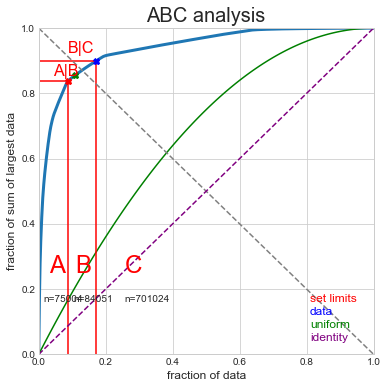

c:\users\roman\appdata\local\programs\python\python37\lib\site-packages\sklearn\preprocessing\_data.py:194: UserWarning:

Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.



In [107]:
from sklearn import decomposition
from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

df_nested_json_group_A = the_best_abc_analysis(df_nested_json_temp)
df_nested_json_group_A

cols_to_remove = []

for col in df_nested_json.columns:
    try:
        _ = df_nested_json[col].astype(float)
    except ValueError:
        print('Couldn\'t covert %s to float' % col)
        cols_to_remove.append(col)
        pass

# keep only the columns in df that do not contain string
df_nested_json_group_A = df_nested_json_group_A[[col for col in df_nested_json_group_A.columns if col not in cols_to_remove]]

df_nested_json_group_A
# df_nested_json_group_A = df_nested_json_temp.join(df_nested_json['ad_type'])
# df_nested_json_group_A = df_nested_json_temp.join(df_nested_json['os_version'])
# df_nested_json_group_A = df_nested_json_temp.join(df_nested_json['city'])

X = df_nested_json_group_A.iloc[:, 0:10].values
y = df_nested_json_group_A.iloc[:, 11].values
standard_X = preprocessing.scale(X)
standard_Y = preprocessing.scale(y)

In [108]:
[(df_nested_json_group_A.columns.get_loc(c), c) for c in df_nested_json_group_A.columns if c in df_nested_json_group_A]

[(0, 'view_index'),
 (1, 'session_view_index'),
 (2, 'cur_ticks'),
 (3, 'session_length'),
 (4, 'revenue'),
 (5, 'ads_ltv'),
 (6, 'ecpm_sma'),
 (7, 'normalized_ecpm_sma'),
 (8, 'value'),
 (9, 'event_timestamp'),
 (10, 'event_receive_timestamp'),
 (11, 'eCPM'),
 (12, 'ad_type'),
 (13, 'os_version'),
 (14, 'city'),
 (15, 'abc')]

In [109]:
def PCA(X , num_components):
     
    #Step-1
    X_meaned = X - np.mean(X , axis = 0)
     
    #Step-2
    cov_mat = np.cov(X_meaned.astype(float) , rowvar = False)
    
    #Step-3
    eigen_values , eigen_vectors = np.linalg.eigh(cov_mat)
     
    #Step-4
    sorted_index = np.argsort(eigen_values)[::-1]
    sorted_eigenvalue = eigen_values[sorted_index]
    sorted_eigenvectors = eigen_vectors[:,sorted_index]
     
    #Step-5
    eigenvector_subset = sorted_eigenvectors[:,0:num_components]

    #Step-6
    X_reduced = np.dot(eigenvector_subset.transpose() , X_meaned.transpose() ).transpose()

    return X_reduced


#Applying it to PCA function
mat_reduced = PCA(standard_X , 3)

#Creating a Pandas DataFrame of reduced Dataset
principal_df = pd.DataFrame(mat_reduced , columns = ['PC1','PC2','PC3'])
#                             'PC4','PC5','PC6','PC7','PC8','PC9','PC10'])

AAA = pd.DataFrame(standard_Y)
AAA.rename(columns={0: 'y'}, inplace=True)

#Concat it with target variable to create a complete Dataset
principal_df = pd.concat([principal_df, AAA] , axis = 1)
principal_df

,PC1,PC2,PC3,y
0,0.721049,-0.605642,1.073406,-0.287119
1,1.153294,-0.554491,1.158952,-0.445386
2,0.452768,-0.642708,1.043407,-0.345657
3,0.818477,-0.726149,0.636260,-0.377227
4,1.165028,-0.521734,1.057225,-0.445386
...,...,...,...,...
74999,-0.213798,2.581614,-0.732934,-0.194128
75000,-1.808620,2.627630,-0.484610,0.034202
75001,-0.279932,2.567937,-0.725197,-0.078899
75002,-0.179395,2.572853,-0.720785,-0.131317


In [110]:
df_nested_json_group_A.columns

Index(['view_index', 'session_view_index', 'cur_ticks', 'session_length',
       'revenue', 'ads_ltv', 'ecpm_sma', 'normalized_ecpm_sma', 'value',
       'event_timestamp', 'event_receive_timestamp', 'eCPM', 'ad_type',
       'os_version', 'city', 'abc'],
      dtype='object')

In [112]:
import plotly.express as px
fig = px.scatter_matrix(df_nested_json_group_A, 
                        dimensions=['eCPM', 'session_length',
                                    'ads_ltv', 'event_receive_timestamp'],
                                    color="ad_type")
fig.show()

Множественная корреляционная матрица показала, что в целом, параметры не коррелируют между собой в разрезе типов рекламы, за исключением некоторых. Замечания описанны ниже.

<img src="Снимок экрана 2022-06-19 203230.png" alt="drawing" width="1000"/>

Замечание: чем короче длина сессии в игре, тем выше величина eCPM. С другой стороны для рекламы типа rv и int имеется тенденция к величению eCPM с увеличением продолжительности сессии в игре 

In [113]:
from sklearn import decomposition
from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import normalize

Data = df_nested_json_group_A[['eCPM', 'session_length', 'ads_ltv', 'cur_ticks']]

Data.iloc[:,0:-1] = Data.iloc[:,0:-1].apply(lambda x: (x-x.mean())/ x.std(), axis=0)

display(Data)
cov_matrix = np.cov(np.transpose(Data))
print('Матрица ковариаций :', cov_matrix, '\n', sep='\n')
eigh_val, eigh_vec = np.linalg.eigh(cov_matrix)


print('Собственные числа: ', eigh_val, '\n', sep='\n')
print('Собственные векторы: ', eigh_vec, '\n', sep='\n')

print('Вклад каждой компоненты в "разброс" признаков (в %):\n', [i/sum(eigh_val)*100 for i in eigh_val])

c:\users\roman\appdata\local\programs\python\python37\lib\site-packages\pandas\core\indexing.py:1851: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,eCPM,session_length,ads_ltv,cur_ticks
3,-0.287118,-0.316631,-0.679270,637797353426827330
4,-0.445383,-0.325960,-0.661466,637797357392197840
20,-0.345655,-0.304422,-0.653031,637797360006785730
39,-0.377224,-0.311214,-0.482297,637797288105819330
44,-0.445383,-0.260308,-0.479693,637797294284810150
...,...,...,...,...
859990,-0.194127,-0.292632,-0.324244,637794433955651710
859991,0.034202,-0.293571,-0.331143,637794433841770450
860034,-0.078899,-0.287441,-0.310431,637794443780927210
860039,-0.131316,-0.318616,-0.301548,637794444878853380


Матрица ковариаций :
[[ 1.00000000e+00 -1.36996553e-02  1.95513385e-02 -3.41693064e+10]
 [-1.36996553e-02  1.00000000e+00  6.90646147e-02  8.17997515e+10]
 [ 1.95513385e-02  6.90646147e-02  1.00000000e+00  6.90658319e+10]
 [-3.41693064e+10  8.17997515e+10  6.90658319e+10  1.24145935e+24]]


Собственные числа: 
[-1.11641767e+03 -1.43099624e-01  9.99810356e-01  1.24145935e+24]


Собственные векторы: 
[[ 1.00000000e+00  1.13289452e-05  1.85880403e-05  2.75235000e-14]
 [ 1.02600563e-05 -9.98400928e-01  5.65295246e-02 -6.57252031e-14]
 [-1.91987366e-05  5.65295244e-02  9.98400928e-01 -5.56327776e-14]
 [ 2.75238918e-14  6.26165786e-14 -5.92650928e-14 -1.00000000e+00]]


Вклад каждой компоненты в "разброс" признаков (в %):
 [-8.992784761436923e-20, -1.1526726548394464e-23, 8.053508612641766e-23, 100.0]


Проведение метода показало, что длина игровой сессии вносит взначительный вклад в разброс дисперсии результарующего показатея. 

In [114]:
import plotly.graph_objects as go

Data_PCA = Data.dot(eigh_vec[:, 1:])
Data_PCA['ad_type'] = df_nested_json_group_A['ad_type']
Data_PCA

fig = go.Figure()
for spec in Data_PCA['ad_type'].unique():
    Data_PCA_spec = Data_PCA[Data_PCA['ad_type']==spec]
    fig.add_trace(go.Scatter3d(x=Data_PCA_spec[0], y=Data_PCA_spec[1], z=Data_PCA_spec[2], mode='markers', name=spec))
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
fig.show()

In [124]:
from sklearn import decomposition
pca = decomposition.PCA(n_components=3)
pca.fit(Data)
pca.transform(Data)
pca.explained_variance_ratio_

array([0.99635317, 0.00126488, 0.00125146])

# Заключение

Необходимо провести тесты на проверку гипотез о равенстве средних и дисперсий результирующего показателя eCPM в разрезах пользователей, городов, версий ОС и выявленных показателей методом главных компонент.
В целом можно скзаать, что существенным образом на выручку от рекламы влияют видеоролики показанные в больших городах, при том, что игроки чаще всего заходят в приложения на короткий период, например, при поездках. 
Также будет полезно провести анализ на зависимость размерности по численности городов. 